## Leah's Strava Stats 2016-2021

Leah started running consistently in the Fall 2016 right around Thanksgiving.

In [1]:
# to convert -- CLI
# jupyter nbconvert --to hide_code_html strava.ipynb
import os
from datetime import datetime
from glob import glob

import pandas as pd
import geopandas as gpd
import shapely
from shapely.geometry import LineString
import matplotlib.pyplot as plt
import seaborn as sns
import folium
from folium.plugins import HeatMap

from stravalib.client import Client
from stravalib.util import limiter

from process_strava import authenticate, swap
from process_strava import get_activities, get_stream_data 


In [2]:
client = Client(rate_limiter=limiter.DefaultRateLimiter())
client = authenticate("strava-secrets.txt", client)

athlete_info = client.get_athlete()
athlete_info

Oops! Your token has expired. No worries - I will refresh it for you.
I've refreshed your token and saved it to a file. Aren't I the best?


<Athlete id=10295934 firstname='Leah' lastname='Wasser'>

In [3]:
# Get all activities which we use to get activity ideas for gps data below
activities = client.get_activities()

Below, I loop through each ativity and add it to a new list object which 
can then be turned into a dataframe for easy parsing below.

Running this cell takes time as it's accessing a lot of data.

In [3]:
daily_data_df_orig = get_activities(client)
daily_data_df_orig.head()

Looks like you've been a busy bee. I've found 1433 activities.
Great! i have everything I need - I'm saving your data to a file called all_activities.csv. 
 Our business is done here. Bye for now!


,activity_id,name,average_speed,distance,elapsed_time,total_elevation_gain,start_date_local,type,year
date,,,,,,,,,
2021-02-22 07:32:23,4830415959,Morning Walk,1.077,4912.0,1:16:58,659.0,2021-02-22T07:32:23,Walk,2021
2021-02-21 08:29:18,4826526176,Mellow 🐻,1.471,10803.0,2:55:27,880.0,2021-02-21T08:29:18,Run,2021
2021-02-20 16:17:13,4820685218,Afternoon Walk,1.251,2899.0,0:39:02,33.0,2021-02-20T16:17:13,Walk,2021
2021-02-20 08:37:40,4819323372,Morning Run,2.164,16384.0,2:10:53,537.0,2021-02-20T08:37:40,Run,2021
2021-02-19 14:55:05,4814350501,Afternoon Run,2.206,10673.0,1:24:57,409.0,2021-02-19T14:55:05,Run,2021


## Summary Data

Below are several tables showing the data in aggregated form.
Summarizing by 

1. Daily Actiities, 
2. Month, 
3. Cumulative by year

This is the data used to create the plots below!

In [5]:
# # Convert units & cleanup data (there could be a cleaner way)
# daily_data_df_orig["elevation_gain_ft"] = daily_data_df_orig["total_elevation_gain"]*3.28084
# daily_data_df_orig["miles"] = daily_data_df_orig.distance * 0.000621371
# daily_data_df_orig["date"] = pd.to_datetime(
#     daily_data_df_orig.start_date_local)
# daily_data_df_orig["miles_per_hour"] = daily_data_df_orig["average_speed"]*2.23694
# daily_data_df_orig["pace_min_miles"] = 60/daily_data_df_orig["miles_per_hour"]

# # Index by date
# daily_data_df_orig.set_index('date', inplace=True)
# # Summarize totals by day
# daily_data_df = daily_data_df_orig.resample("D").sum()
# # Add year and doy
# daily_data_df["year"] = daily_data_df.index.year
# daily_data_df["doy"] = daily_data_df.index.dayofyear

In [6]:
# all_activities_orig = daily_data_df_orig.copy()

In [7]:
# # Clean up runs less that a tenth of a mile! & remove swimming
# all_activities_clean = all_activities_orig[all_activities_orig.miles > .1]
# all_activities_clean = all_activities_orig[all_activities_orig.type != "Swim"]
# # For weird watch start activities that aren't actually runs
# all_activities_clean = all_activities_clean[all_activities_clean.pace_min_miles < 100]

# all_activities_clean.replace({'Walk': 'Hike',
#                               'BackcountrySki': 'xc-ski-snowshoe',
#                               'NordicSki': 'xc-ski-snowshoe',
#                               'Snowshoe': 'xc-ski-snowshoe'},
#                              inplace=True)

# Spatial Data - The GPS Points Representing Runs on a Map 

This post helped me access this data with `stravalib`. Again stravalib is a Python 
package that makes it easier to access the strava API and associated data requests.

https://medium.com/analytics-vidhya/accessing-user-data-via-the-strava-api-using-stravalib-d5bee7fdde17  


In [8]:
# activity_number = 0
# types = ['time', 'distance', 'latlng', 'altitude',
#          'velocity_smooth', 'moving', 'grade_smooth']
# #activity_data=client.get_activity_streams(df['id'][activity_number], types=types)

# act = 4506113699
# activity_data = client.get_activity_streams(act, types=types)
# activity_data

## Grab spatial run data

The effort below is rate-limited. I figured this out somewhere in another notebook.
The better option is to save each year as a csv file and open the data to process it.


In [9]:
# def get_stream_data(client, theyear, df, types):
#     """Downloads data from strava for a specific year.
#     Assumes authentication is already in place"""

#     # Subset to the year of interest
#     subset = df[df.index.year == theyear]
#     # Loop through each activity and get the latlon data
#     # this is a big request that will hit rate limits if provided with too many activities at once
#     gdf_list = []
#     for i, act in enumerate(subset["activity_id"].values):
#         act_data = client.get_activity_streams(act,
#                                                types=types)
#         # print(act)
#         # Some activities have no information associated with them
#         if act_data:
#             try:
#                 gdf_list.append([act,
#                                  LineString(act_data["latlng"].data),
#                                  act_data["latlng"].data])
#             except KeyError:
#                 # some activities have no gps data like swimming and short activities
#                 print(
#                     "LatLon is missing from activity {}. Moving to next activity".format(act))

#     print("You have made {} requests. Strava limits requests to 600 every 15 mins".format(i))
#     print(datetime.now())
#     df = pd.DataFrame(gdf_list,
#                       columns=["activity_id", "geometry", "xy"])

#     gdf = gpd.GeoDataFrame(df,
#                            geometry=df.geometry,
#                            crs="EPSG:4326")
#     # Swap xy - using swap function below
#     # gdf["geometry"] = gdf.geometry.map(
#     # lambda polygon: shapely.ops.transform(lambda x, y: (y, x), polygon))

#     gdf.geometry = gdf.geometry.map(swap)
#     # Export to shapefile
#     file_name = os.path.join("data", "strava_data_" + str(theyear) + ".shp")
#     gdf[["activity_id", "geometry"]].to_file(file_name)

#     return gdf

In [10]:
# Test for a single request - it's not working now
# client = client
# theyear=2021
# df= daily_data_df_orig
# types=types


# subset = df[df.index.year == theyear]
# gdf_list = []
# # for i, act in enumerate(subset["activity_id"].values):
# #     print(act)
# act = subset["activity_id"].values[0]
# act
# act_data = client.get_activity_streams(act,
#                                        types=types)
# act_data

### Download Spatial Data By Year

This operation hits significant rate limits so it's best to 
do it year by year. 

Strava limits used to be 600 every 15 mins. It may be less now but 
it is definitely less with the free account

In [4]:
types = ['time', 'distance', 
         'latlng', 'altitude',
         'velocity_smooth', 
         'moving', 'grade_smooth']

In [12]:
# data_2016_gdf = get_stream_data(2016, daily_data_df_orig, types)
# data_2017_gdf = get_stream_data(2017, daily_data_df_orig, types)
# data_2018_gdf = get_stream_data(2018, daily_data_df_orig, types)
# data_2019_gdf = get_stream_data(2019, daily_data_df_orig, types)
# data_2020_gdf = get_stream_data(client,
#                                 2020,
#                                 daily_data_df_orig,
#                                 types)

# data_2021_gdf = get_stream_data(client,
#                                 2021,
#                                 daily_data_df_orig,
#                                 types)

# open 2021


In [13]:
# Save all data as is as a pickle for now
#import pickle

# Create a list of all gdf objects
# TODO - change this to open years 2016-2020 when 2020 is done and to
# # then add 2021
# all_years = [data_2020_gdf,
#              data_2019_gdf,
#              data_2018_gdf,
#              data_2017_gdf,
#              data_2016_gdf]

# with open('strava_data', 'wb') as all_years_file:
#     pickle.dump(all_years, all_years_file


# Add 2021 gdf to data?

In [14]:
# The 2021 data will need to be added each time

In [6]:
# Open each of the spatial datasets
all_shpfiles = sorted(glob(os.path.join("data", "*.shp")))

# Open each shapefile & concat for plotting
all_years = []
for afile in all_shpfiles[0:1]:
    all_years.append(gpd.read_file(afile))

all_years_gdf = pd.concat(all_years,
                          ignore_index=True)

In [7]:
all_years_gdf

,activity_i,geometry
0,817287721,"LINESTRING (-105.23126 39.95262, -105.23126 39..."
1,815204318,"LINESTRING (-105.25658 39.96686, -105.25658 39..."
2,813143257,"LINESTRING (-105.25800 39.96605, -105.25800 39..."
3,811180767,"LINESTRING (-105.28294 39.99933, -105.28294 39..."
4,810641241,"LINESTRING (-105.34451 40.01601, -105.34451 40..."
...,...,...
72,625626242,"LINESTRING (-105.25570 39.96657, -105.25567 39..."
73,622615929,"LINESTRING (-105.25576 39.96659, -105.25579 39..."
74,610259295,"LINESTRING (-105.25579 39.96650, -105.25580 39..."
75,610255851,"LINESTRING (-105.25563 39.96669, -105.25573 39..."


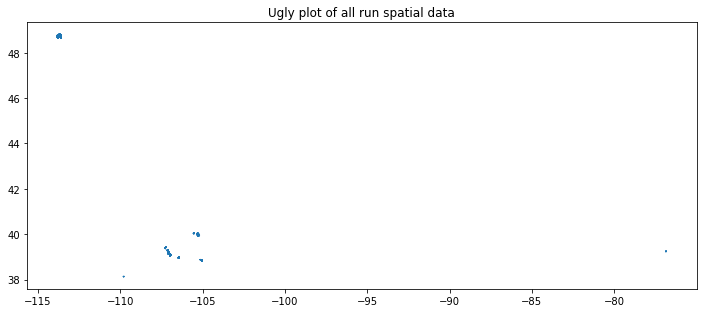

In [8]:
f, ax = plt.subplots(figsize=(12, 6))
all_years_gdf.plot(ax=ax)
ax.set(title="Ugly plot of all run spatial data")
plt.show()

In [18]:
# data_2020_gdf = gpd.read_file(all_shpfiles[4])
# # Plot of 2020 data only 
# f, ax = plt.subplots()
# data_2020_gdf.plot(ax=ax)
# ax.set(title="Leah's 2020 Adventures")
# plt.show()

## Interactive Map of All Activities

Below is an interactive plot of my data from 2020!

TODO's:

1. Add other years of data
2. Add label popups maybe?? tbd as lots of overlapping lines here

In [19]:
# Simplify 202 data
# data_simp = data_2021_gdf.copy()
# data_simp["geometry"] = data_simp.simplify(tolerance=.01)

In [20]:
# Plot 2020 data only
# m = folium.Map([39.95, -105.2],
#                zoom_start=11)

# for index, row in data_simp.iterrows():
#     folium.PolyLine(
#         row.xy,
#         line_weight=3,
#         color="purple",
#         opacity=.5
#     ).add_child(folium.Popup(str(row.activity_id))).add_to(m)

# m

In [9]:
# 2021 data
all_years_gdf.head(3)

,activity_i,geometry
0,817287721,"LINESTRING (-105.23126 39.95262, -105.23126 39..."
1,815204318,"LINESTRING (-105.25658 39.96686, -105.25658 39..."
2,813143257,"LINESTRING (-105.25800 39.96605, -105.25800 39..."


Below, i'm grabbing only the 2021 dtaa and creating a heat map.
there are bunch of nuances to consider here

1. error in gps - you can see each run points may be close but slightly "off" yielding a less accurate and less clean heat map
2. selecting the gradient of colors. 

lots to play with here to make the final map a bit cleaner. 

In [10]:
def clean_points(gdf):
    # swap x and y for folium because it wants lat first not lon
    gdf["geometry"] = gdf.geometry.map(swap)

    # Get points

    gdf['points'] = gdf.apply(
        lambda x: [y for y in x['geometry'].coords], axis=1)


    line_list = []
    for aline in gdf.points:
        line_list.append([list(tpl) for tpl in aline])

    # now flatten it - this should be all runs in 2021
    return [item for sublist in line_list for item in sublist]
    
    

In [13]:
all_points = clean_points(all_years_gdf)
len(all_points)

470611

In [14]:
# # Because this takes a while to process, it could make sense to process and export as pickle
# all_years_gdf_points = all_years_gdf.copy()

# # swap x and y for folium because it wants lat first not lon
# all_years_gdf_points["geometry"] = all_years_gdf_points.geometry.map(swap)

# # Get points

# all_years_gdf_points['points'] = all_years_gdf_points.apply(
#     lambda x: [y for y in x['geometry'].coords], axis=1)


# line_list = []
# for aline in all_years_gdf_points.points:
#     line_list.append([list(tpl) for tpl in aline])

# # now flatten it - this should be all runs in 2021
# flat_list = [item for sublist in line_list for item in sublist]
all_points[4]

[39.952583, -105.231225]

In [15]:
# Save all points as a pickle - maybe process by year and save it out?
all_points[0:400]

[[39.95262, -105.231263],
 [39.95262, -105.231263],
 [39.95261, -105.231253],
 [39.952598, -105.231239],
 [39.952583, -105.231225],
 [39.952565, -105.23121],
 [39.952546, -105.231197],
 [39.952526, -105.231185],
 [39.952506, -105.231175],
 [39.952487, -105.231164],
 [39.952467, -105.231154],
 [39.952447, -105.231145],
 [39.952429, -105.231137],
 [39.95241, -105.23113],
 [39.952393, -105.231126],
 [39.952376, -105.231121],
 [39.952359, -105.231116],
 [39.952342, -105.231107],
 [39.952325, -105.231097],
 [39.952307, -105.231088],
 [39.952288, -105.23108],
 [39.95227, -105.231074],
 [39.952253, -105.231067],
 [39.952236, -105.231062],
 [39.952219, -105.231058],
 [39.952198, -105.231058],
 [39.952178, -105.231062],
 [39.952156, -105.231072],
 [39.952139, -105.231082],
 [39.952124, -105.231094],
 [39.952109, -105.231101],
 [39.952092, -105.231107],
 [39.952071, -105.231111],
 [39.952052, -105.231119],
 [39.952034, -105.231131],
 [39.952017, -105.231144],
 [39.952001, -105.231155],
 [39.9519

In [16]:
# Generate a heat map
m = folium.Map([39.96, -105.27], zoom_start=14)
HeatMap(all_points, 
        name="runs",
        radius=4, blur=5,
       gradient = {0.1: 'thistle', 
                   0.3: 'lime',
                   0.7: 'orange', 
                   1: 'indigo'}).add_to(m)

m

In [19]:
# Simplify all data
all_years_simp = all_years_gdf.copy()
all_years_simp["geometry"] = all_years_simp.simplify(tolerance=.01)

all_years_simp.crs = "EPSG:4326"

In [27]:
m = folium.Map([39.95, -105.2],
               zoom_start=11) 
folium.Choropleth(
    all_years_simp,
    line_weight=3,
    line_color='blue'
).add_to(m)
 
m

In [20]:
# Patience - this is parsing a LOT of activities

m = folium.Map([39.95, -105.2],
               zoom_start=11)

for aline in all_years_simp.xy:
    folium.PolyLine(
        aline,
        line_weight=3,
        color="purple",
        opacity=.5
    ).add_to(m)

m

AttributeError: 'GeoDataFrame' object has no attribute 'xy'

In [ ]:
# this is parsing a LOT of activities
map_data.crs = "EPSG:4326"

m = folium.Map([39.95, -105.2],
               zoom_start=11)

for aline in map_data.xy:
    folium.PolyLine(
        aline,
        line_weight=3,
        color="purple",
        opacity=.5
    ).add_to(m)

m